# Plot results

This notebooks allows to generate comparative plots and skill maps for all the available versions saved of a model. 

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys
sys.path.append('/'.join(sys.path[0].split('/')[:-1]))

import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import time
import os
import healpy as hp
import random
import pickle
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm, colors

from modules.test import compute_rmse_healpix
from modules.full_pipeline import compute_errors, plot_climatology
from modules.plotting import plot_general_skills, plot_benchmark, plot_skillmaps, plot_benchmark_simple, plot_rmses, plot_benchmark
from modules.data import hp_to_equiangular
from modules.mail import send_info_mail


import warnings
warnings.filterwarnings("ignore")

### Define model to generate plots

In [3]:
models_to_compare = []
for ep in range(12):
    name = 'all_const_len2_delta_6_architecture_loss_v0' + \
    '_8steps_increas_reinitialize_residual_l3_long_connections_per_epoch_epoch_{}'.format(ep) 
    models_to_compare.append(name)

In [4]:
file_preds = 'all_const_len2_delta_6_architecture_loss_v0_8steps_increas_reinitialize_residual_l3_long_connections_per_epoch'

In [5]:
description = '8steps_increas_reinitialize_residual_l3_long_connections_per_epoch'

**IMPORTANT:**

Set `compute_full_plots` to `True` if you want to generate **all** the skills plots. Otherwise only rmse comparison plots will be displayed.

In [72]:
compute_full_plots = False

#### Load data

In [6]:
datadir = "../data/healpix/"
input_dir = datadir + "5.625deg_nearest/"
model_save_path = datadir + "models/"
pred_save_path = datadir + "predictions/"
prediction_path = '../data/healpix/predictions/'

In [7]:
chunk_size = 521
len_sqce = 2
# define time resolution
delta_t = 6

# predict 5days data
max_lead_time = 5*24
in_features = 7
out_features = 2

resolution = 5.625
lead_time = 6
start_time = len_sqce * lead_time - 6
end_time = (6-lead_time) if (6-lead_time) > 0 else None

# Data
lead_times = np.arange(lead_time, max_lead_time+lead_time, lead_time)

In [8]:
preds = []
names = []
for ep, name in enumerate(models_to_compare):
    try:
        pred = xr.open_mfdataset(prediction_path + file_preds \
                                 + name + '.nc', combine='by_coords', chunks={'time':chunk_size})
        preds.append(pred)
        names.append('Epoch {}'.format(ep))
    except:
        print('Epoch {} not available'.format(ep))

Epoch 0 not available
Epoch 1 not available
Epoch 2 not available
Epoch 3 not available
Epoch 4 not available
Epoch 5 not available
Epoch 6 not available
Epoch 7 not available
Epoch 8 not available
Epoch 9 not available
Epoch 10 not available
Epoch 11 not available


### Load RMSE and generate comparative plots

In [9]:
obsc = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})
#obsc = obsc.isel(time=slice(6,pred.time.shape[0]+6))

In [10]:
metrics_path = '../data/healpix/metrics/'
figures_path = '../data/healpix/figures/' + description + '/'

In [11]:
if not os.path.isdir(figures_path):
    os.mkdir(figures_path)

In [12]:
rmse_models_to_compare = []
for ep, name in enumerate(models_to_compare):
    rmse_spherical = xr.load_dataset(metrics_path + 'rmse_' + name + '.nc')
    rmse_models_to_compare.append(rmse_spherical)

In [13]:
names = ['Epoch {}'.format(ep) for ep in range(len(models_to_compare))]

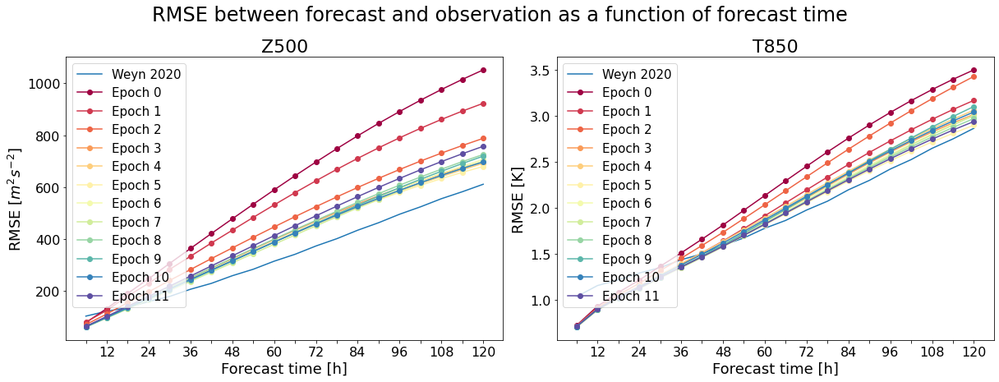

In [14]:
plot_benchmark_simple(rmse_models_to_compare, description, lead_times, input_dir=metrics_path, output_dir=figures_path, \
                          title=True, filename=description+'_comparison', names=names)

In [15]:
models_to_compare[5]

'all_const_len2_delta_6_architecture_loss_v0_8steps_increas_reinitialize_residual_l3_long_connections_per_epoch_epoch_5'

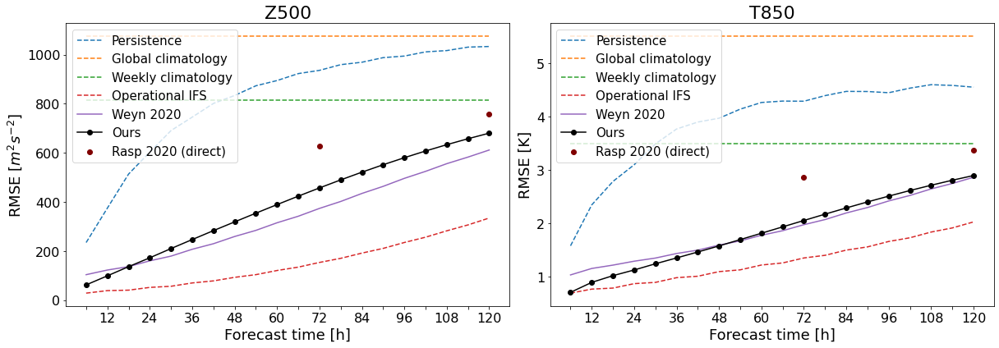

In [16]:
plot_benchmark(rmse_models_to_compare[5], description, lead_times, 
               input_dir=metrics_path, output_dir=figures_path, title=False)

In [17]:
rmses_weyn = xr.open_dataset(metrics_path + 'rmses_weyn.nc').rename({'z500':'z', 't850':'t'})

### Print results at t=6h and t=120h 

In [18]:
def print_error_values(model):
    print('Breakeven Z500')
    be_z = np.where(rmses_weyn.z.values[:len(model.z.values)] < model.z.values)
    print((be_z[0][0])*6, 'h')

    print('Breakeven t850')
    be_t = np.where(rmses_weyn.t.values[:len(model.z.values)] < model.t.values)
    print((be_t[0][0])*6, 'h')

    print('Values at t=6h')
    print('z500: {:.3f}'.format( model.z.values[0]))
    print('t850: {:.3f}'.format(model.t.values[0]))

    print('Values at t=120h')
    print('z500: {:.3f}'.format( model.z.values[-1]))
    print('t850: {:.3f}'.format(model.t.values[-1]))
    print('\n')

In [19]:
for i in range(4,6):
    print('Epoch ', i)
    model = rmse_models_to_compare[i]
    print_error_values(model)

    

Epoch  4
Breakeven Z500
18 h
Breakeven t850
36 h
Values at t=6h
z500: 62.278
t850: 0.714
Values at t=120h
z500: 691.907
t850: 3.065


Epoch  5
Breakeven Z500
18 h
Breakeven t850
48 h
Values at t=6h
z500: 61.580
t850: 0.711
Values at t=120h
z500: 680.024
t850: 2.901




### Generate skillmaps

In [39]:
pred_group_path = 'all_const_len2_delta_6_architecture_loss_v0_8steps_increas_reinitialize_residual_l3_per_epoch/'
pred = xr.open_mfdataset(prediction_path + pred_group_path + \
                         'all_const_len2_delta_6_architecture_loss_v0_8steps_increas_reinitialize_residual_l3_per_epoch_epoch_7.nc', combine='by_coords', chunks={'time':chunk_size})


In [31]:
#pred = preds[6]
#ep = 6
#compute_full_plots = True

In [40]:
obsc = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})

obsc = obsc.isel(time=slice(6,pred.time.shape[0]+6))

In [41]:
compute_full_plots = True

In [42]:
figures_path = '../data/healpix/figures/' + pred_group_path

if not os.path.isdir(figures_path):
    os.mkdir(figures_path)

loading data
time to load data:  83.61923933029175
time mean obs  32.28979539871216
time mean pred  37.195960998535156
time std obs  68.18783402442932
time std pred  68.53618216514587
time cov  93.9692690372467
time corre_map  0.004338741302490234
time rbias map  57.38943004608154
time rsd map  0.002415895462036133
time rmse map  66.7060956954956


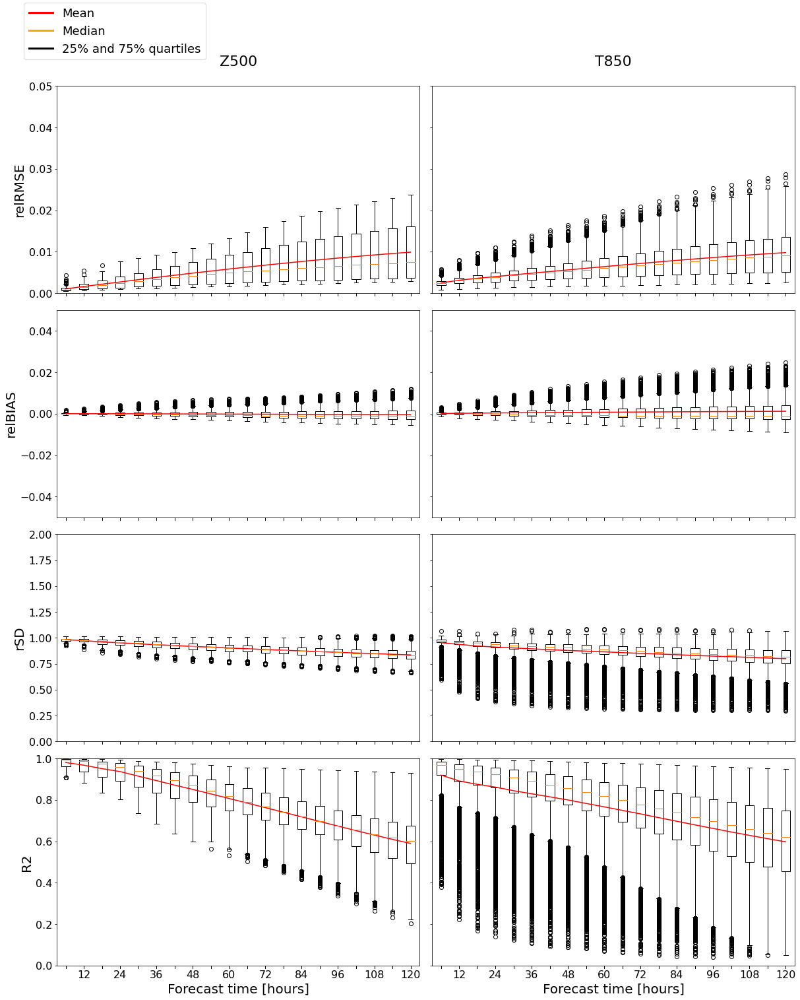

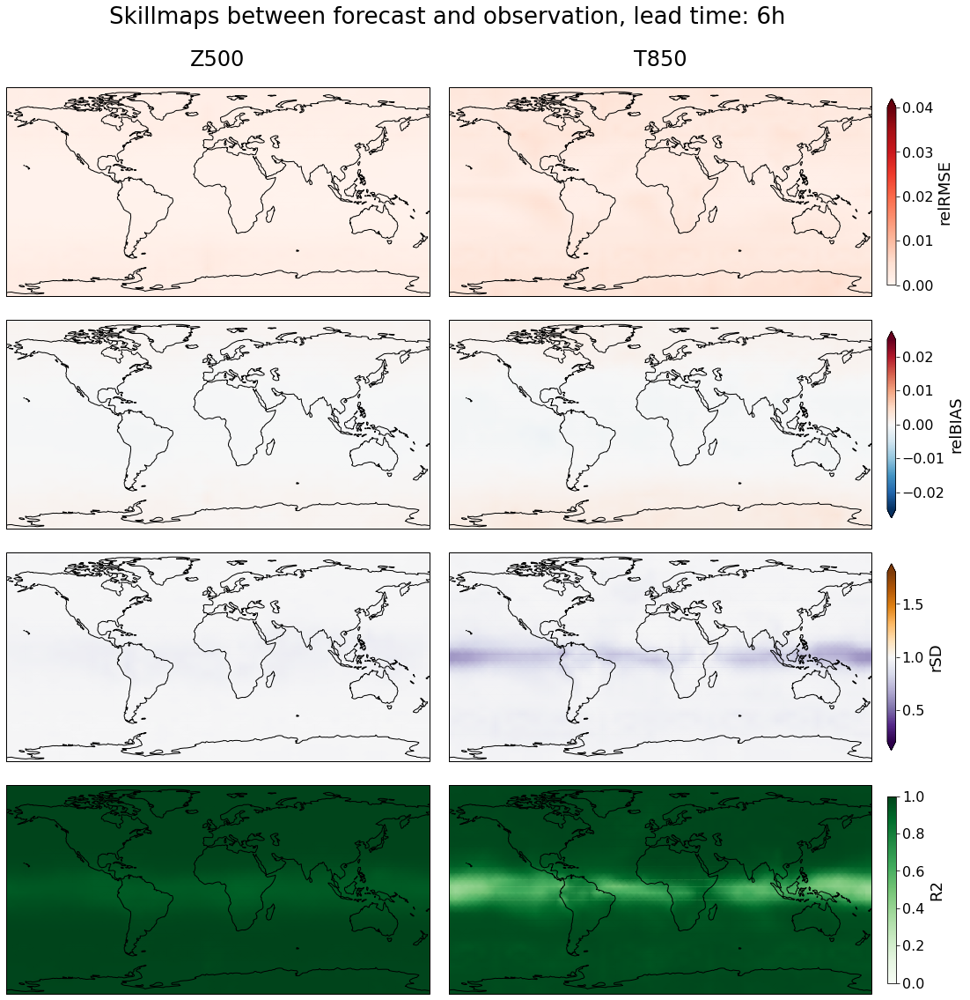

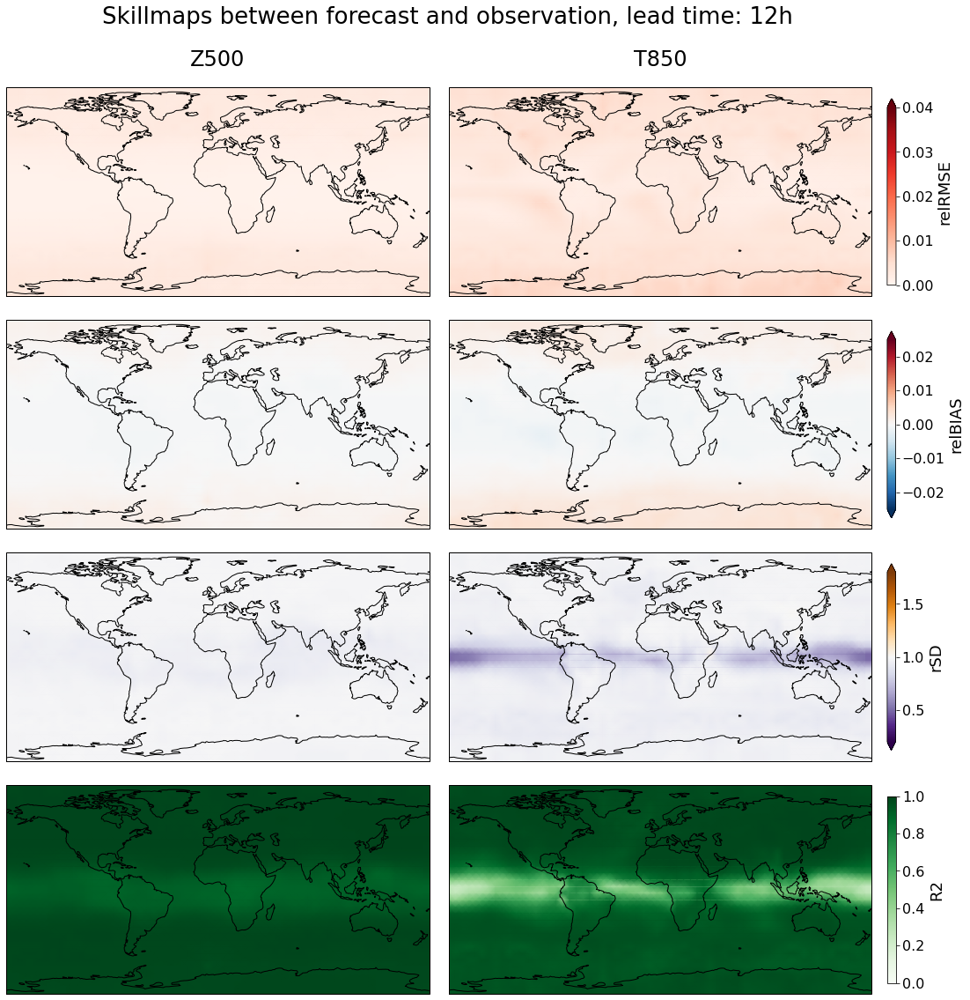

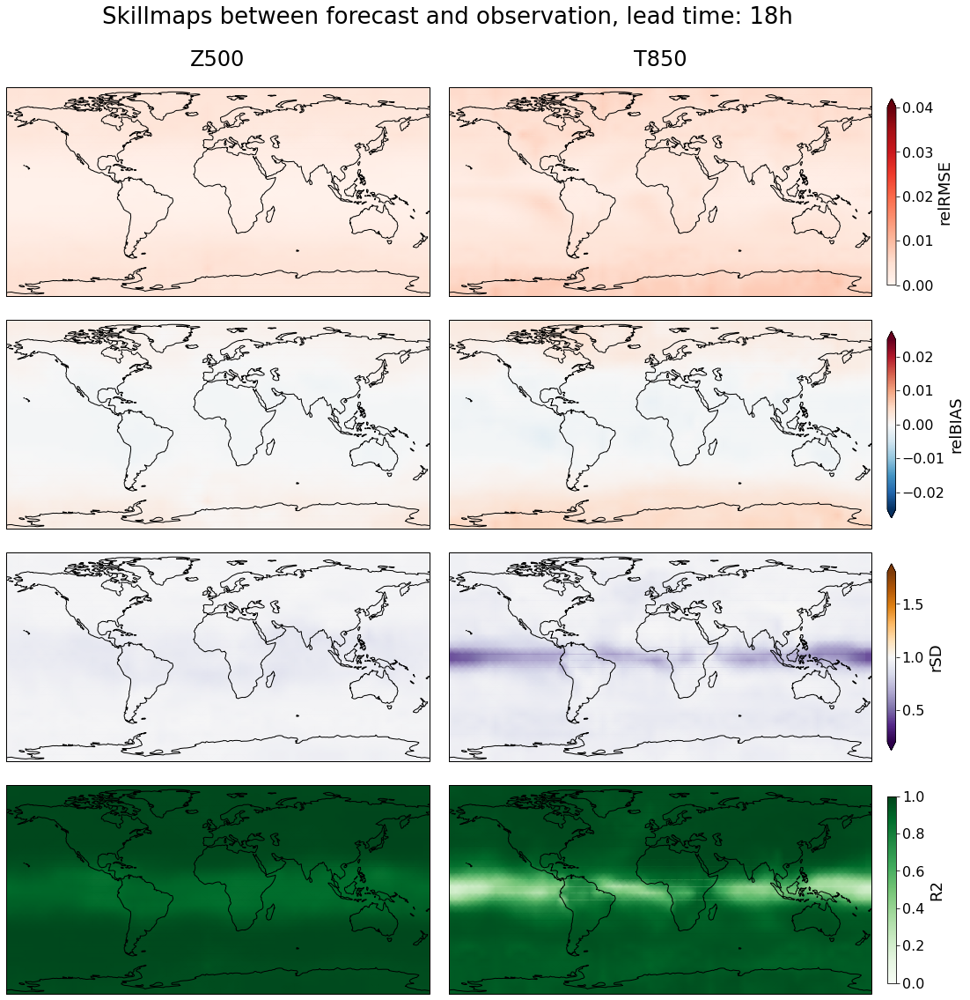

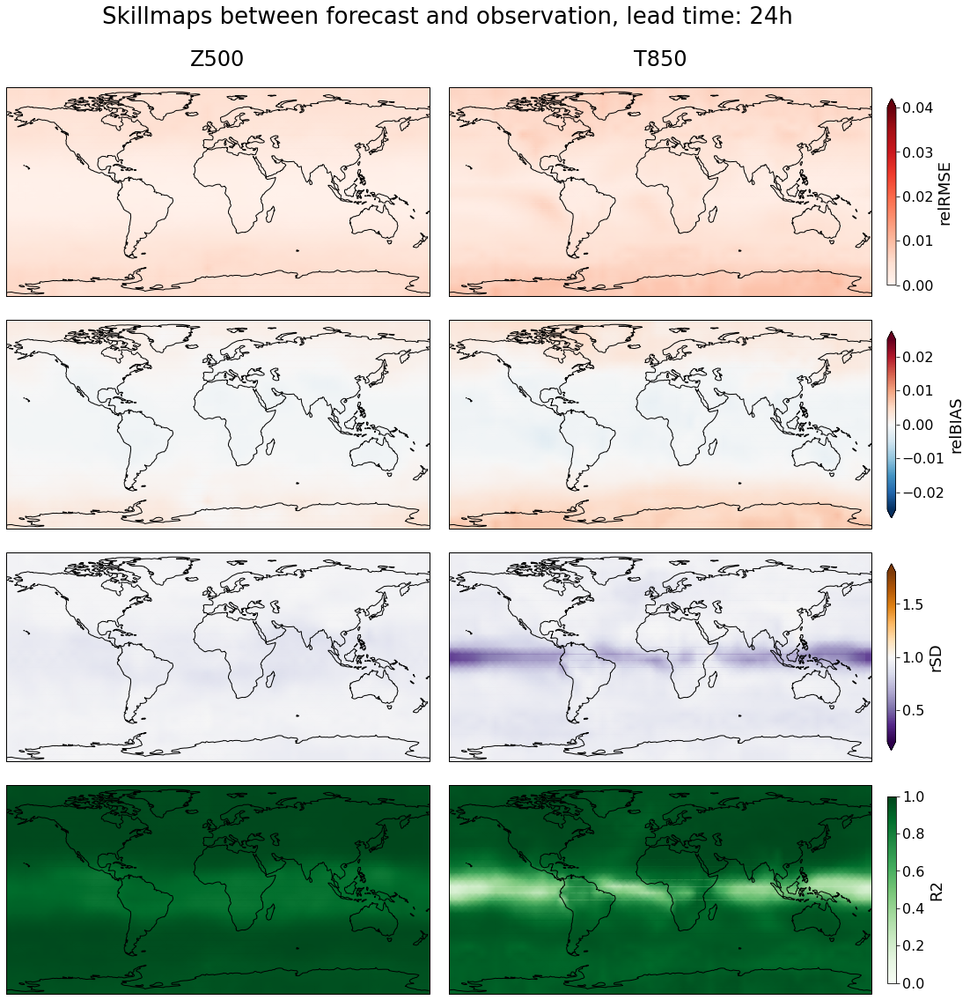

...

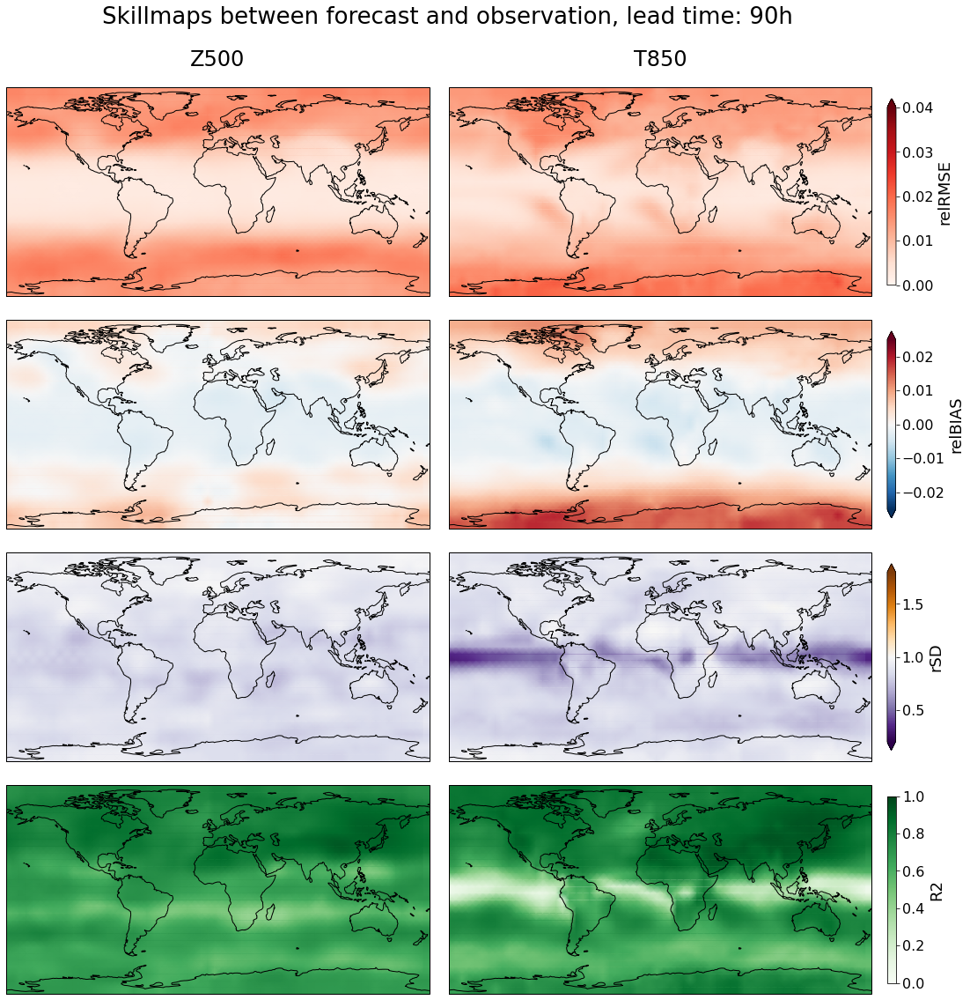

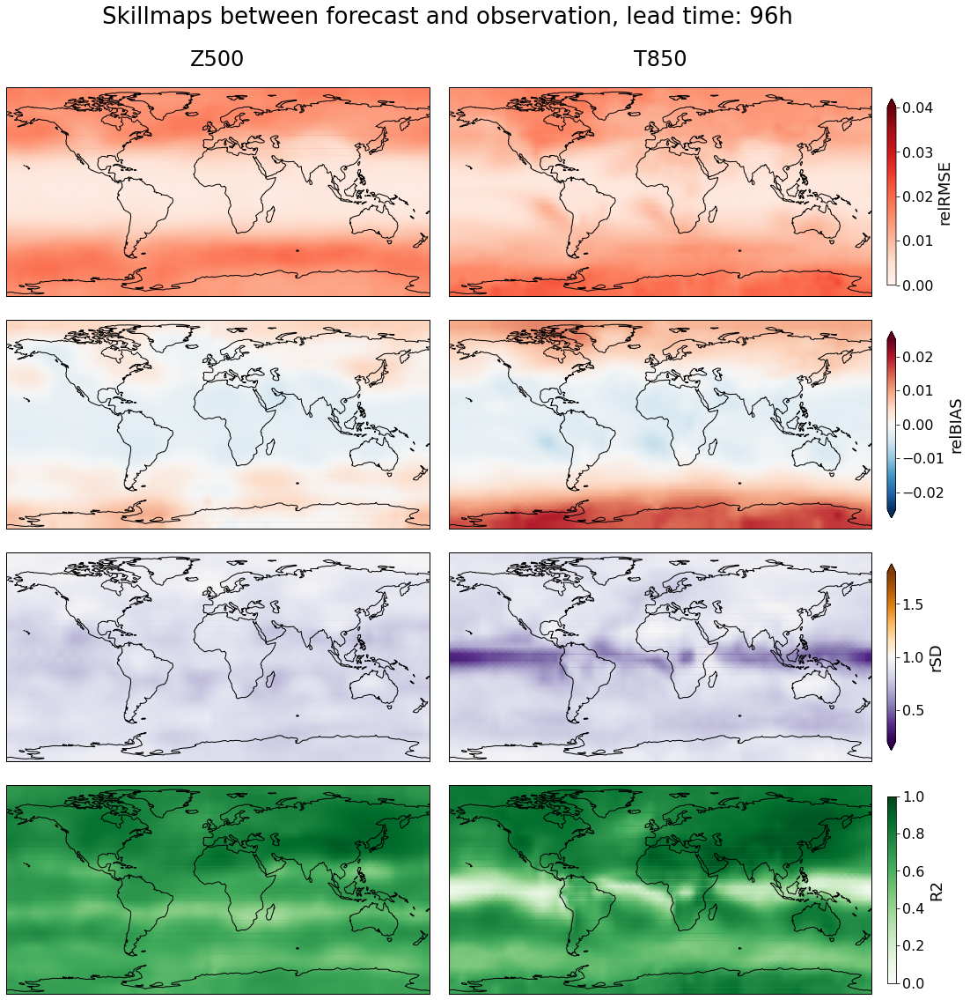

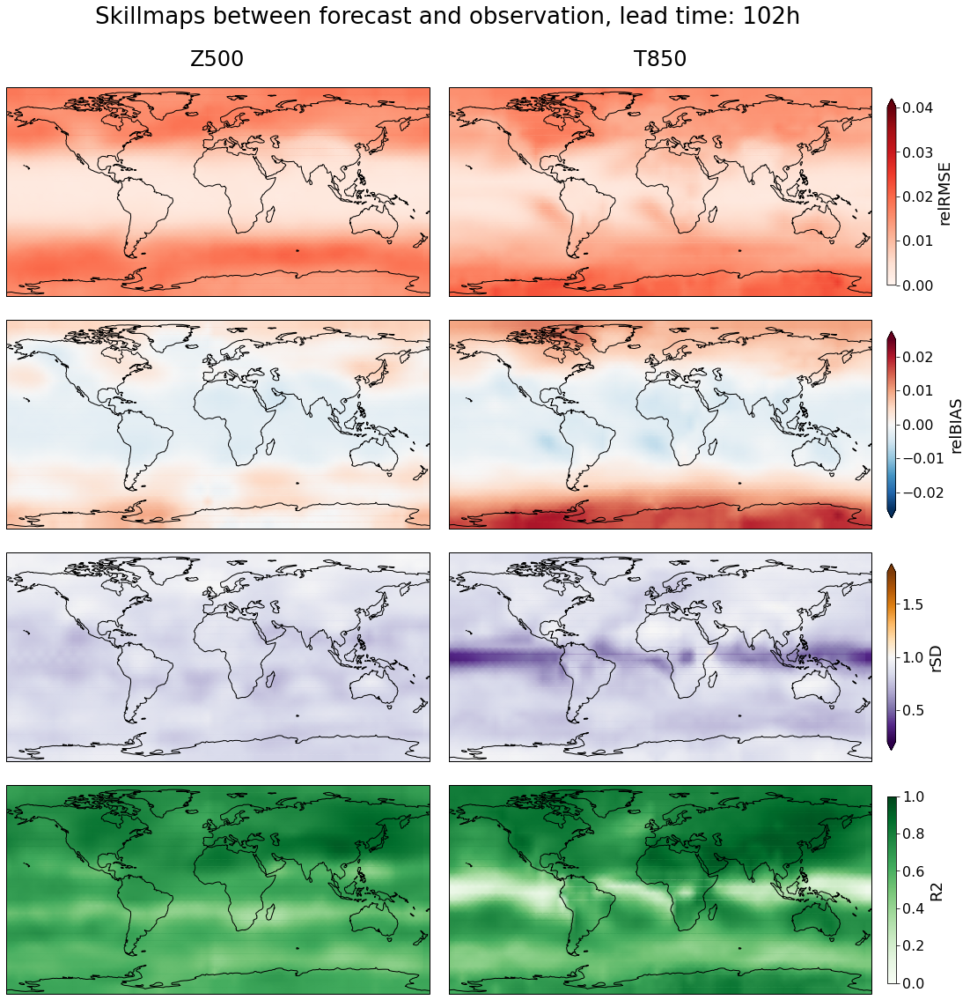

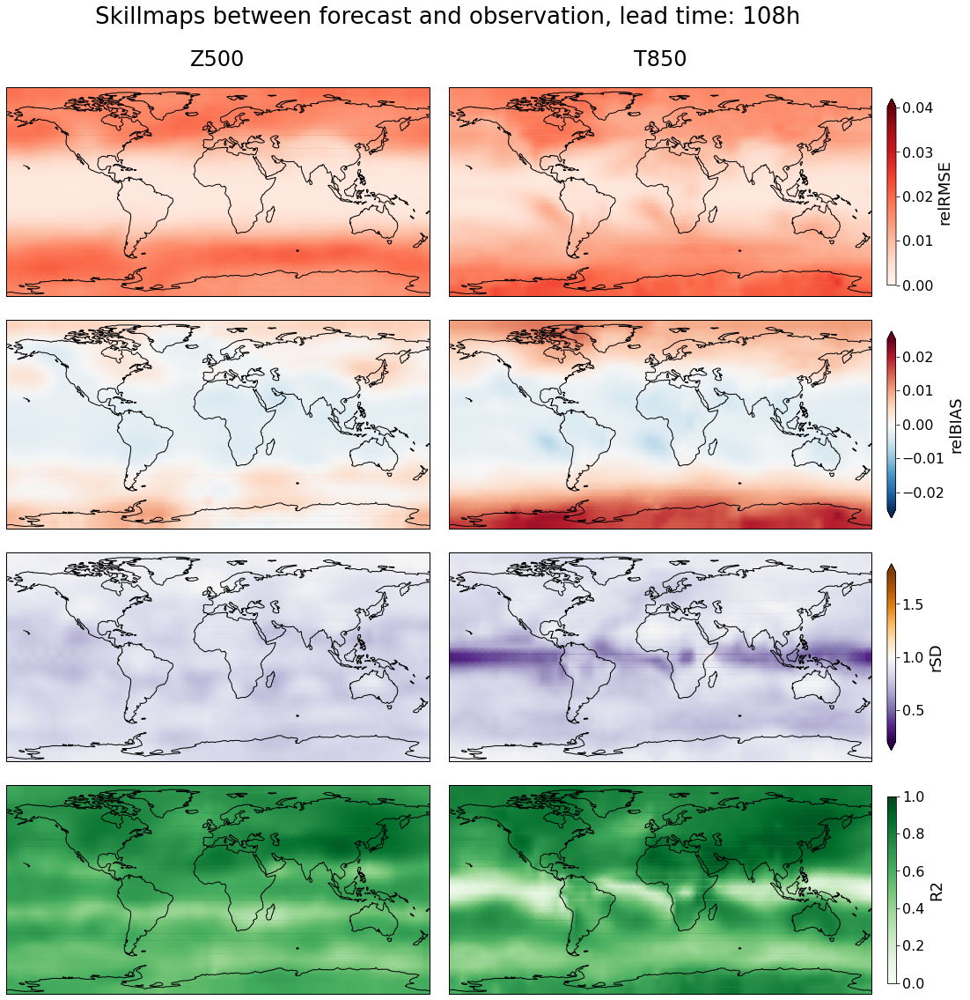

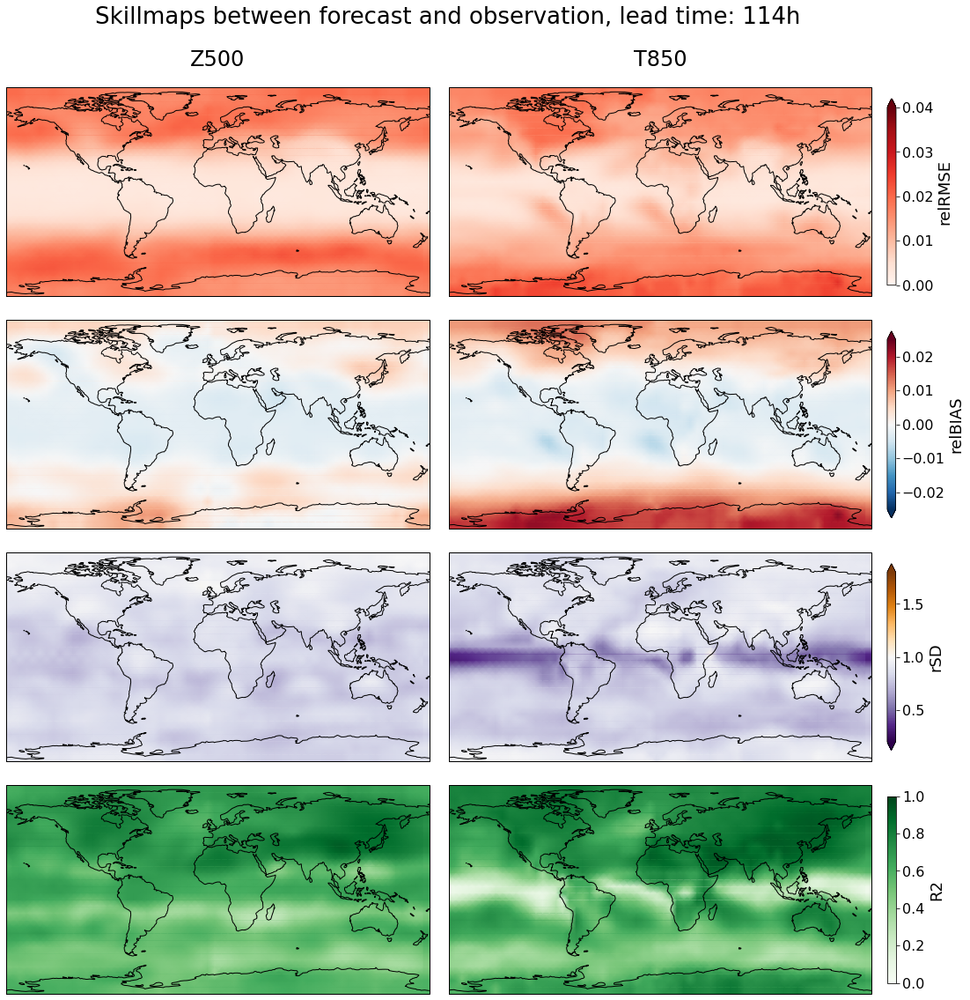

In [ ]:
if compute_full_plots:
    corr_map, rbias_map, rsd_map, rmse_map, obs_rmse, rmse_map_norm = compute_errors(pred, obsc)
    rbias_spherical = rbias_map.mean('node').compute()
    rsd_spherical = rsd_map.mean('node').compute()
    corr_spherical = corr_map.mean('node').compute()

    plot_general_skills(rmse_map_norm, corr_map, rbias_map, rsd_map, description + '_epoch_{}'.format(ep), lead_times, 
                output_dir=figures_path, title=False)

    plot_skillmaps(rmse_map_norm, rsd_map, rbias_map, corr_map, description + '_epoch_{}'.format(ep), lead_times, resolution, 
           output_dir=figures_path)

## Plots for single model (no epochs comparison)

#### Load data

In [3]:
datadir = "../data/healpix/"
input_dir = datadir + "5.625deg_nearest/"
model_save_path = datadir + "models/"
pred_save_path = datadir + "predictions/"
prediction_path = '../data/healpix/predictions/'

In [4]:
chunk_size = 521
len_sqce = 2
# define time resolution
delta_t = 6

# predict 5days data
max_lead_time = 5*24
in_features = 7
out_features = 2

resolution = 5.625
lead_time = 6
start_time = len_sqce * lead_time - 6
end_time = (6-lead_time) if (6-lead_time) > 0 else None

# Data
lead_times = np.arange(lead_time, max_lead_time+lead_time, lead_time)

In [105]:
description = 'all_const_len2_delta_6_architecture_spherical_unet_residual_short_4levels_ND_5epochs'

In [106]:
pred = xr.open_mfdataset(prediction_path  + description + '.nc', combine='by_coords', chunks={'time':chunk_size})

In [107]:
obsc = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})


In [108]:
metrics_path = '../data/healpix/metrics/'
figures_path = '../data/healpix/figures/' + description + '/'

In [109]:
if not os.path.isdir(figures_path):
    os.mkdir(figures_path)

In [110]:
rmse_spherical = xr.load_dataset(metrics_path + 'rmse_' + description + '.nc')

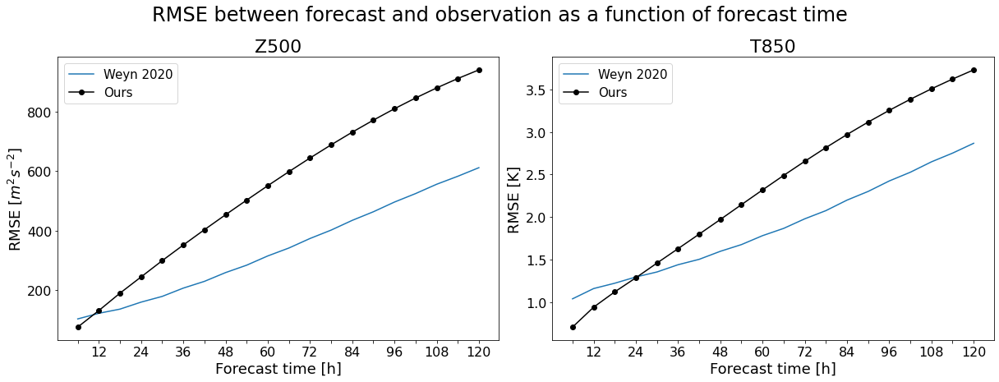

In [111]:
plot_benchmark_simple(rmse_spherical, description, lead_times, input_dir=metrics_path, output_dir=figures_path, \
                          title=True, filename=description)

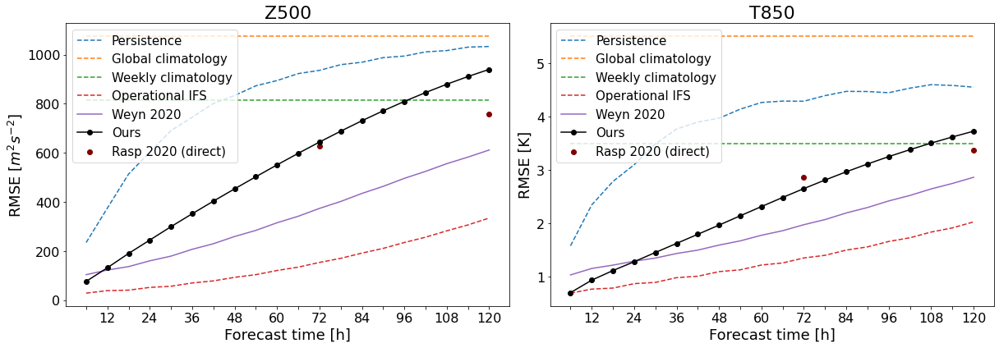

In [112]:
plot_benchmark(rmse_spherical, description, lead_times, 
               input_dir=metrics_path, output_dir=figures_path, title=False)

In [113]:
rmses_weyn = xr.open_dataset(metrics_path + 'rmses_weyn.nc').rename({'z500':'z', 't850':'t'})

### Print results at t=6h and t=120h 

In [114]:
model = rmse_spherical

print('Breakeven Z500')
be_z = np.where(rmses_weyn.z.values[:len(model.z.values)] < model.z.values)
print((be_z[0][0])*6, 'h')

print('Breakeven t850')
be_t = np.where(rmses_weyn.t.values[:len(model.z.values)] < model.t.values)
print((be_t[0][0])*6, 'h')

print('Values at t=6h')
print('z500: ', model.z.values[0])
print('t850: ', model.t.values[0])

print('Values at t=120h')
print('z500: ', model.z.values[-1])
print('t850: ', model.t.values[-1])

Breakeven Z500
6 h
Breakeven t850
24 h
Values at t=6h
z500:  75.76014335330413
t850:  0.7054962047004599
Values at t=120h
z500:  940.0021782668681
t850:  3.731179128148018


#### Load data

In [20]:
datadir = "../data/healpix/"
input_dir = datadir + "5.625deg_nearest/"
model_save_path = datadir + "models/"
pred_save_path = datadir + "predictions/"
prediction_path = '../data/healpix/predictions/'

In [21]:
chunk_size = 521
len_sqce = 2
# define time resolution
delta_t = 6

# predict 5days data
max_lead_time = 5*24
in_features = 7
out_features = 2

resolution = 5.625
lead_time = 6
start_time = len_sqce * lead_time - 6
end_time = (6-lead_time) if (6-lead_time) > 0 else None

# Data
lead_times = np.arange(lead_time, max_lead_time+lead_time, lead_time)

In [31]:
description1 = 'all_const_len2_delta_6_architecture_loss_v0_8steps_increas_reinitialize_residual_l3_per_epoch_epoch_7'
description2 = 'all_const_len2_delta_6_architecture_loss_v0_8steps_increas_reinitialize_residual_l3_per_epoch_epoch_10'
description7 = 'all_const_len2_delta_6_architecture_loss_v0_8steps_increas_reinitialize_residual_l3_long_connections_per_epoch_epoch_5'
description3 = 'all_const_len2_delta_6_architecture_loss_v0_8steps_constant_decresing_l3_per_epoch_epoch_6'
description4 = 'all_const_len2_delta_6_architecture_loss_v0_8steps_constant_increasing_l3_per_epoch_epoch_5'
description5 = 'spherical_unet_3days_direct_forecast_epoch6'
description6 = 'all_const_len2_delta_6_architecture_loss_v0_8steps_constant_increasing_static_l3_long_connections_per_epoch_epoch_7'

In [32]:
models = [description1, description2, description7, description3, description4, description6, description5]

In [33]:
names = ['varying (ep 7)', 'varying (ep 11)', 'varying - long', 'constant decr', 'constant incr', 'constant incr long', 'direct-6h']

In [25]:
obsc = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})


In [26]:
metrics_path = '../data/healpix/metrics/'
figures_path = '../data/healpix/figures/'  

In [27]:
if not os.path.isdir(figures_path):
    os.mkdir(figures_path)

In [34]:
rmse_to_compare = []
for description in models:
    rmse_spherical = xr.load_dataset(metrics_path + 'rmse_' + description + '.nc')
    rmse_to_compare.append(rmse_spherical)

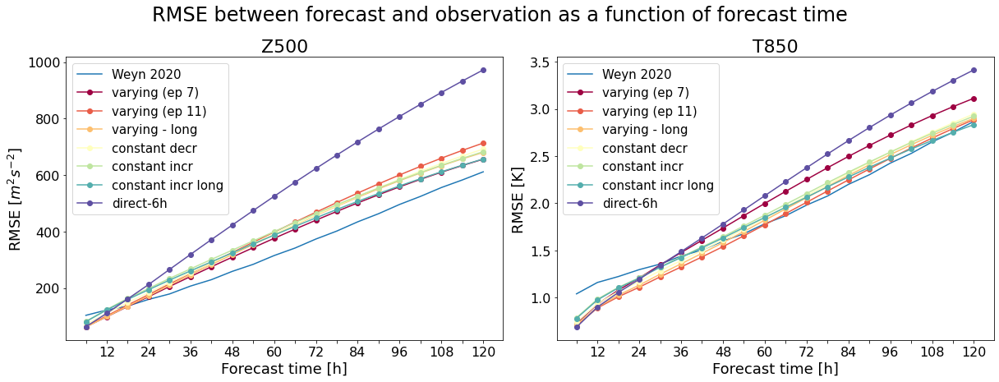

In [35]:
plot_benchmark_simple(rmse_to_compare, description, lead_times, input_dir=metrics_path, output_dir=figures_path, \
                          title=True, filename=description+'_comparison', names=names)

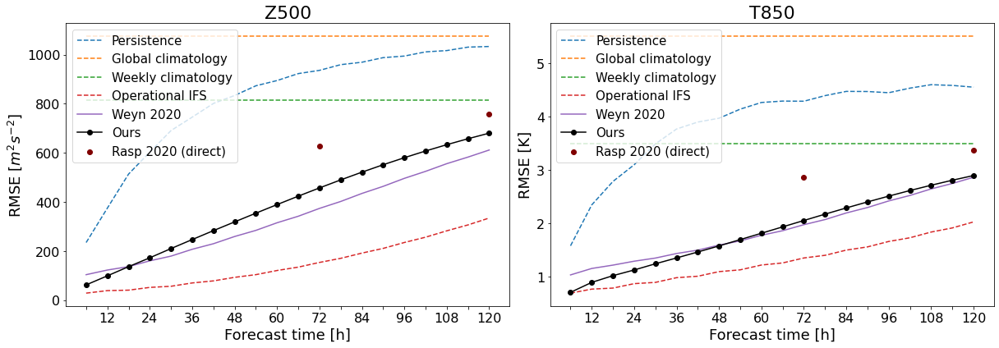

In [37]:
plot_benchmark(rmse_to_compare[2], description, lead_times, 
               input_dir=metrics_path, output_dir=figures_path, title=False)

In [173]:
rmses_weyn = xr.open_dataset(metrics_path + 'rmses_weyn.nc').rename({'z500':'z', 't850':'t'})

### Print results at t=6h and t=120h 

In [38]:
for model, name in zip(rmse_to_compare, names):
    print(name)
    print_error_values(model)
    print('\n')

varying (ep 7)
Breakeven Z500
18 h
Breakeven t850
30 h
Values at t=6h
z500: 62.495
t850: 0.724
Values at t=120h
z500: 655.998
t850: 3.113




varying (ep 11)
Breakeven Z500
12 h
Breakeven t850
60 h
Values at t=6h
z500: 63.394
t850: 0.704
Values at t=120h
z500: 713.212
t850: 2.887




varying - long
Breakeven Z500
18 h
Breakeven t850
48 h
Values at t=6h
z500: 61.580
t850: 0.711
Values at t=120h
z500: 680.024
t850: 2.901




constant decr
Breakeven Z500
12 h
Breakeven t850
42 h
Values at t=6h
z500: 70.707
t850: 0.736
Values at t=120h
z500: 692.072
t850: 2.947




constant incr
Breakeven Z500
6 h
Breakeven t850
36 h
Values at t=6h
z500: 81.515
t850: 0.785
Values at t=120h
z500: 682.465
t850: 2.924




constant incr long
Breakeven Z500
6 h
Breakeven t850
36 h
Values at t=6h
z500: 80.812
t850: 0.778
Values at t=120h
z500: 656.791
t850: 2.833




direct-6h
Breakeven Z500
12 h
Breakeven t850
30 h
Values at t=6h
z500: 62.894
t850: 0.685
Values at t=120h
z500: 972.269
t850: 3.414




